# Potential Injuries in CT Scans of Trauma Patients

### Author: Babak Davani
### Date: 2023-10-19

# Problem Area
My area of interest is detecting severe injuries and active internal bleeding in abdominal organs, particularly focusing on blunt force abdominal trauma. This presents a critical challenge in emergency medicine as prompt diagnosis is crucial for effective treatment.

## User and Benefits
The stakeholders impacted by these challenges include:
- Emergency medicine doctors and nurses
- ED administrators
- Surgeons
- Radiologists
- Most importantly, patients who have experienced blunt force abdominal trauma, often as a result of motor vehicle accidents. 

The project's outcomes hold the potential to significantly enhance their experience by enabling faster and more precise diagnoses, ultimately increasing the likelihood of a positive recovery.

## Impact
The potential impact of this project is significant. Efficiently detecting and classifying injuries can lead to expedited treatment, potentially saving lives in emergency situations. Additionally, it can reduce the overall cost of healthcare by minimizing the time spent on diagnosis and treatment planning. This could translate to substantial savings in healthcare expenses, as well as an improvement in the quality of life for affected individuals.

## Data Source
- **RSNA Abdominal Trauma Detection Challenge**

## Dataset Description
This dataset, provided by the Radiological Society of North America (RSNA), contains a diverse collection of abdominal trauma images with associated annotations indicating injuries and bleeding.

## Reference
[RSNA Abdominal Trauma Detection Challenge](https://www.rsna.org/en/education/ai-resources-and-training/ai-image-challenge/Abdominal-Trauma-Detection)


In [1]:
# import libraries for .nii and .dcm files
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import re

from IPython.display import HTML

import pydicom
from PIL import Image

import os
from glob import glob
import tqdm
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [2]:
data_dir = "S:/Capston/data2"
SAVE_FOLDER = "S:/_tmp/"

In [3]:
train_df = pd.read_csv(os.path.join(data_dir,'train.csv'))
train_df.head()
train_df.shape

(3147, 15)

In [9]:
# train_df[(train_df["kidney_healthy"]==1) & (train_df["liver_healthy"]==1) & (train_df["spleen_healthy"]==1) & (train_df["bowel_healthy"]==1)]

In [5]:
# Checking for null values in the entire train_df
null_values = train_df.isnull().sum()

# To get a summary of null values
print(null_values)

patient_id               0
bowel_healthy            0
bowel_injury             0
extravasation_healthy    0
extravasation_injury     0
kidney_healthy           0
kidney_low               0
kidney_high              0
liver_healthy            0
liver_low                0
liver_high               0
spleen_healthy           0
spleen_low               0
spleen_high              0
any_injury               0
dtype: int64


In [5]:
# train_images = glob(os.path.join(data_dir, 'train_images', '*/*'))

In [6]:
# len(train_images)

In [7]:
# train_images = [path.replace("\\", "/") for path in train_images]

In [8]:
series_meta_df = pd.read_csv(os.path.join(data_dir,'train_series_meta.csv'))

In [9]:
image_labels_df = pd.read_csv(os.path.join(data_dir,'image_level_labels.csv'))

In [10]:
image_labels_df.shape

(12029, 4)

In [11]:
# Checking for null values in the entire train_df
null_values = image_labels_df.isnull().sum()

# To get a summary of null values
print(null_values)

patient_id         0
series_id          0
instance_number    0
injury_name        0
dtype: int64


In [12]:
image_labels_df.head()

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation
2,10004,21057,364,Active_Extravasation
3,10004,21057,365,Active_Extravasation
4,10004,21057,366,Active_Extravasation


In [13]:
image_labels_df['injury_name'].unique()

array(['Active_Extravasation', 'Bowel'], dtype=object)

In [14]:
series_meta_df.shape

(4711, 4)

In [15]:
series_meta_df.head(3)

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0


In [16]:
series_meta_df['series_id'].nunique()

4711

In [17]:
train_df['patient_id'].nunique()

3147

In [18]:
# list_img =os.listdir(os.path.join(data_dir,'train_images/'))

In [19]:
# type(list_img)

In [20]:
image_df = pd.read_csv(os.path.join(data_dir,'images.csv'), index_col=0)
image_df.shape

(1500653, 3)

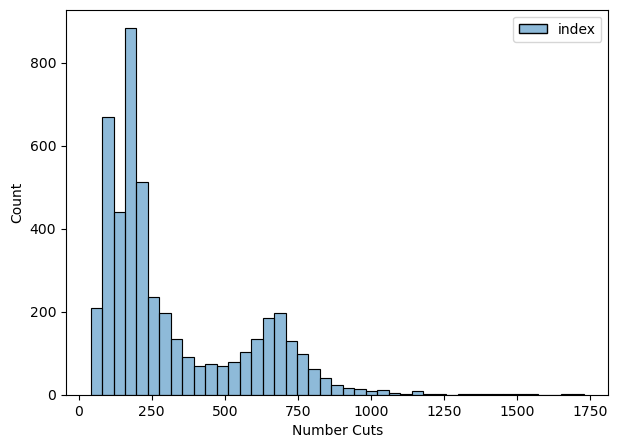

In [21]:
# calculate number of cuts in each serie
cuts = image_df.groupby(["patient_id","series"]).count()

# make histogram.
plt.figure(figsize=(7,5))
sns.histplot(cuts)
plt.xlabel("Number Cuts")
plt.ylabel("Count")
plt.show()

checking to see the distibution of Injury

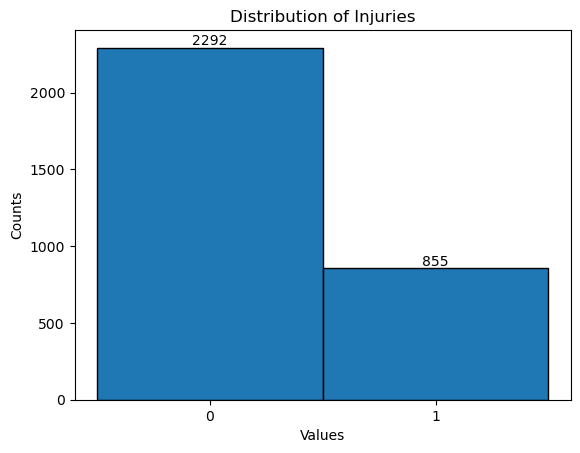

In [22]:
from collections import Counter
# Count the occurrence of each value
counts = Counter(train_df.iloc[:, -1])
# Make the histogram using plt.hist, bins must be integer
plt.hist(train_df.iloc[:, -1], bins=[-0.5, 0.5, 1.5], edgecolor='black')

plt.title('Distribution of Injuries')
plt.xlabel('Values')
plt.ylabel('Counts')

# Display counts above bars
for x, y in counts.items():
    plt.text(x, y, str(y), ha='center', va='bottom')

plt.xticks([0, 1])
plt.show()

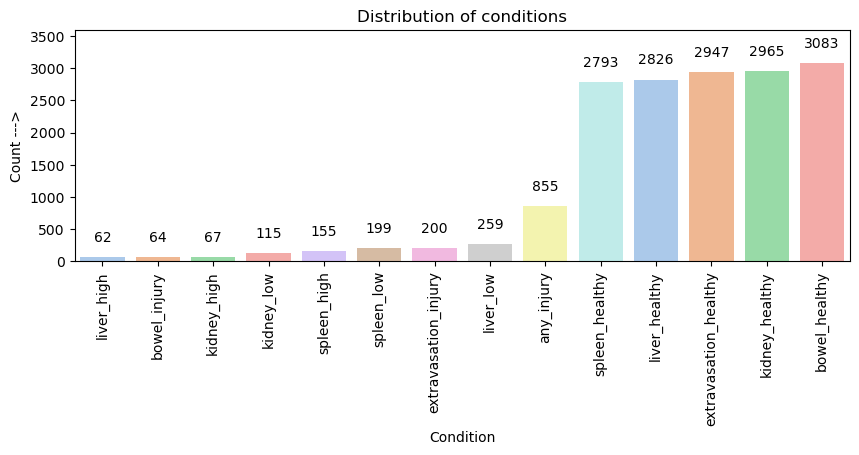

In [23]:
organ_columns = ['bowel', 'kidney', 'liver', 'spleen']

   
organ_counts = pd.DataFrame({
    'Organ': train_df.columns[1:],
    'count': [train_df[column].sum() for column in train_df.columns[1:]]
})

plt.figure(figsize=(10, 3))
palette = sns.color_palette("pastel", len(organ_counts['Organ'].unique()))
ax = sns.barplot(data=organ_counts.sort_values(by='count'), x='Organ', y='count', palette=palette, hue="Organ")
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', 
                xytext = (0, 9), 
                textcoords = 'offset points')
plt.xticks(rotation=90)
plt.title("Distribution of conditions")
plt.xlabel("Condition")
plt.ylim((0,3600))
plt.ylabel("Count --->")
plt.show()

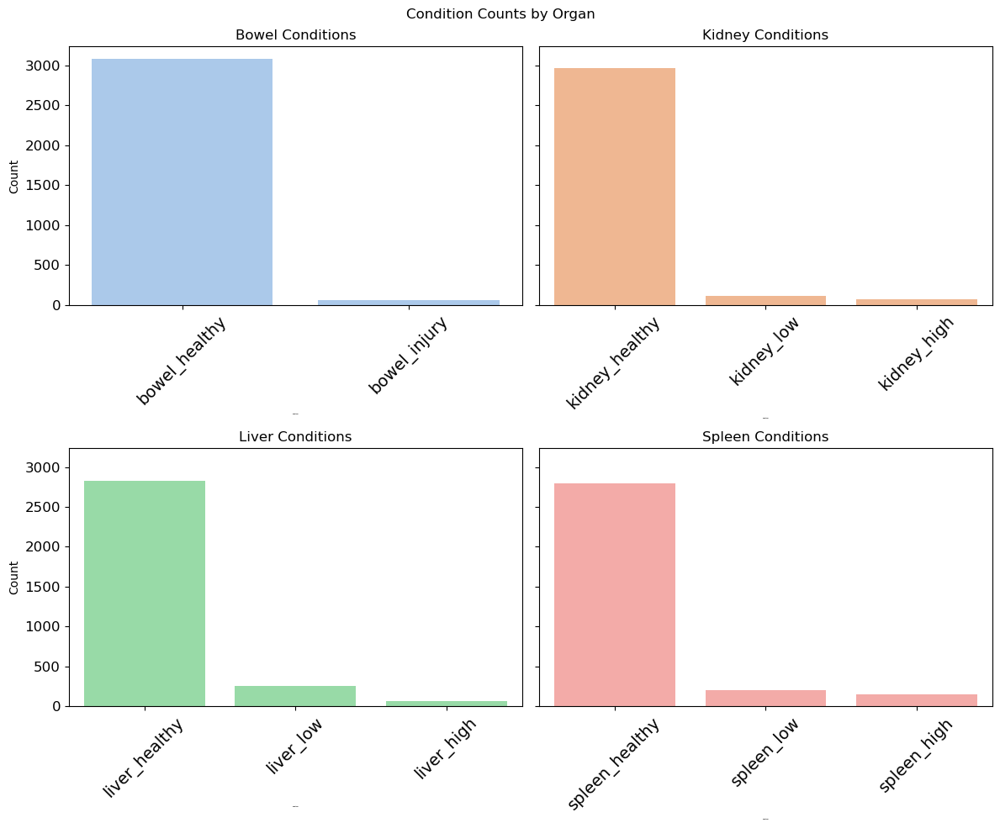

In [24]:
# Create a pastel color palette
palette = sns.color_palette("pastel", len(organ_columns))

# Creating 2x2 subplots for each organ
fig, axes = plt.subplots(2, 2, figsize=(12, 10), sharey=True)
fig.suptitle('Condition Counts by Organ')

for i, organ in enumerate(organ_columns):
    # Determine the subplot location
    ax = axes[i // 2, i % 2]

    # Filter the DataFrame for the current organ
    organ_data = organ_counts[organ_counts['Organ'].str.contains(organ)]
    
    # Create a bar plot for each organ with its unique color
    sns.barplot(ax=ax, data=organ_data, x='Organ', y='count', color=palette[i])
    ax.set_title(f'{organ.capitalize()} Conditions')
    ax.set_xlabel('Condition', fontsize=0, weight='bold')  # Set larger and bolder font
    ax.set_ylabel('Count')
    ax.tick_params(axis='x', rotation=45, labelsize=14)
    ax.tick_params(axis='y', labelsize=12)

plt.tight_layout()
plt.savefig( "Organ_condition.png", dpi=600)
plt.show()

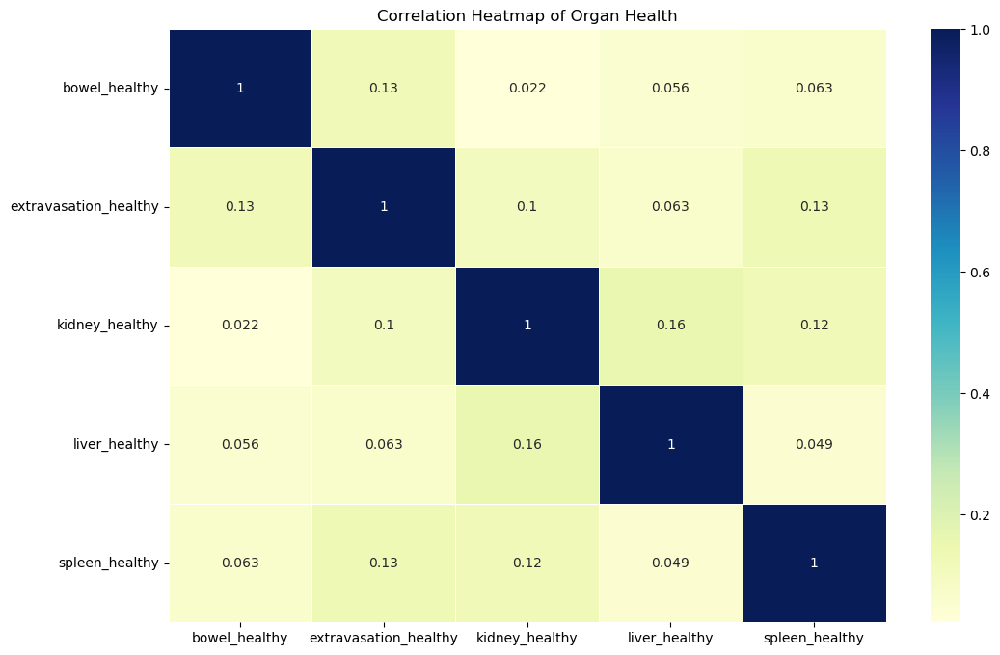

In [25]:
# Selecting columns related to the health of organs
health_columns = [
    "bowel_healthy", "extravasation_healthy", "kidney_healthy", 
    "liver_healthy", "spleen_healthy",
]

# Calculating the correlation matrix for the selected columns
correlation_matrix = train_df[health_columns].corr()

# Plotting the heatmap to visualize the correlations
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="YlGnBu", linewidths=.5)
plt.title("Correlation Heatmap of Organ Health")
plt.show()

The correlations between different health columns are generally small, indicating that the healthy state of one organ might not be strongly related to the healthy state of other organs. Furthermore, there is no strong correlation between any two specific health-related columns, suggesting that the health status of different organs is relatively independent of each other.


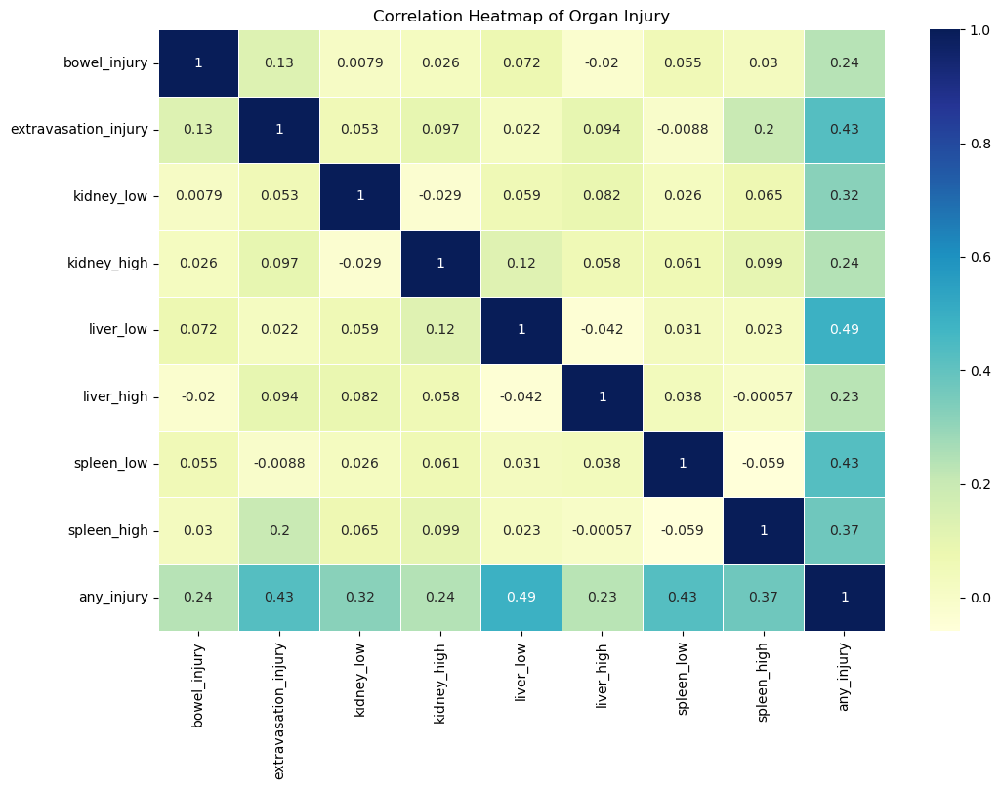

In [26]:
# Selecting columns related to the health of organs
injury_columns = [
    "bowel_injury", "extravasation_injury",
    "kidney_low", "kidney_high", 
    "liver_low", "liver_high",
    "spleen_low", "spleen_high",
    "any_injury"
]

# Calculating the correlation matrix for the selected columns
correlation_matrix = train_df[injury_columns].corr()

# Plotting the heatmap to visualize the correlations
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="YlGnBu", linewidths=.5)
plt.title("Correlation Heatmap of Organ Injury")
plt.show()

- The `any_injury` column is moderately to strongly correlated with all other injury columns, suggesting that it may be a summary measure of injury presence across different organs.
- There are some specific correlations between individual injury types, such as the correlation between `extravasation_injury` and `spleen_high`.
- The correlations between the low and high levels of organ injuries (e.g., `kidney_low` and `kidney_high`) are generally lower, indicating that these might be independent conditions.
- The correlation between different organs' injuries is generally low, which might suggest that injuries to different organs occur independently of each other ⁵.


In [27]:
image_labels_df.shape

(12029, 4)

In [28]:
image_labels_df['injury_name'].value_counts()

injury_name
Active_Extravasation    6370
Bowel                   5659
Name: count, dtype: int64

In [29]:
image_labels_df['patient_id'].nunique()

246

In [30]:
image_labels_df.head(2)

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation


In [31]:
series_meta_df.head()

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0
3,10007,47578,329.00,0
4,10026,29700,327.00,0


In [32]:
list_img = pd.read_csv(os.path.join(data_dir,'images.csv'), index_col=0)

In [33]:
list_img.head()

,patient_id,series,index
0,10004,21057,0
1,10004,21057,1
2,10004,21057,2
3,10004,21057,3
4,10004,21057,4


In [51]:
series_meta_df[series_meta_df['patient_id']==16645]

,patient_id,series_id,aortic_hu,incomplete_organ
551,16645,29832,511.0,0
552,16645,4123,199.0,0


In [54]:
# reading .png files
# first sample
patient =  series_meta_df["patient_id"][10]
series = series_meta_df["series_id"][10]
file_1 = [os.path.join(data_dir,'train_images/') + str(int(patient))+"_"+str(int(series))+"_"+str(int(index)).zfill(4)+".png"\
                                                                                                  for index in list_img.loc[(list_img['patient_id']==patient) & (list_img['series']==series)]['index']]
# second sample
patient =  16645
series = 29832
file_2 = [os.path.join(data_dir,'train_images/') + str(int(patient))+"_"+str(int(series))+"_"+str(int(index)).zfill(4)+".png"\
                                                                                                  for index in list_img.loc[(list_img['patient_id']==patient) & (list_img['series']==series)]['index']]


Animation size has reached 21035093 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


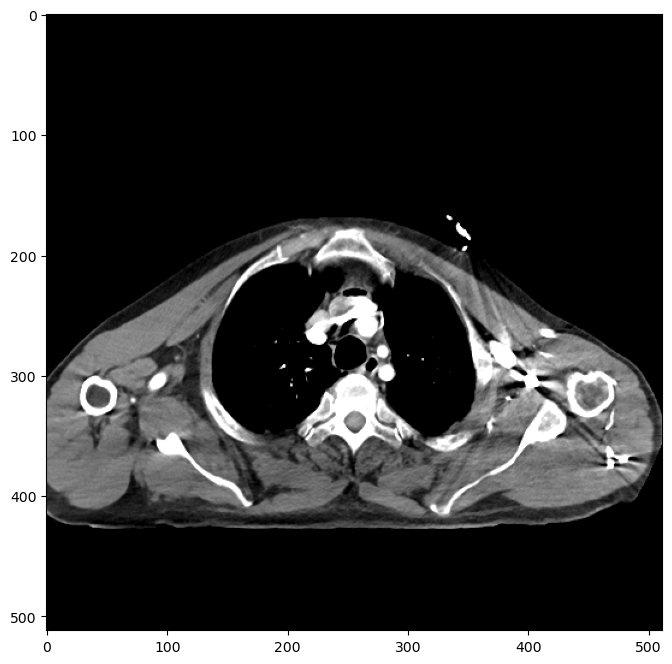

In [55]:
# Read the PNG files and extract the pixel arrays
png_images = [Image.open(f) for f in file_2]
pixel_arrays = [np.array(img.convert('L')) for img in png_images]

# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the first frame and keep the plot object for later
im = ax.imshow(pixel_arrays[0], cmap='gray')

# Define an update function that iterates over your images
def update(i):
    im.set_array(pixel_arrays[i])
    return [im]

# Create an animation object
ani = animation.FuncAnimation(fig, update, frames=range(len(pixel_arrays)), repeat=True)

# Show the animation
HTML(ani.to_jshtml())



In [ ]:
# # Writing a HTML file
html_content = ani.to_jshtml()

# # Specify the file path and name
file_path = 'output.html'

# # Write the HTML content to the file
with open(file_path, 'w') as file:
    file.write(html_content)

<div id="container" style="position:relative;">
<div style="position:relative; float:right"><img style="height:100px""width: 100px" src ="icons/Project logo.png" />
</div>
</div>